## Notebook setup

In [44]:
from itertools import chain
from itertools import product
import numpy as np
import anndata as ad
import pandas as pd
import scanpy as sc
import scanpy.external as sce
import harmonypy as harmony
import seaborn as sns
from scipy import io
from scipy import sparse
# import scvelo as scv
# import cellrank as cr

In [45]:
# import IPython
# import tkinter

In [46]:
import gc
gc.enable()

In [47]:
sc.settings.verbosity = 3             # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(
    dpi_save=400, dpi=200, 
    transparent=False, 
    color_map="plasma"
)

scanpy==1.9.1 anndata==0.7.6 umap==0.5.1 numpy==1.21.2 scipy==1.7.1 pandas==1.3.2 scikit-learn==0.24.2 statsmodels==0.12.2 python-igraph==0.9.6 pynndescent==0.5.4


In [48]:
 import matplotlib
 import matplotlib.pyplot as plt
#  plt.style.use('ggplot')
 matplotlib.use('Qt5Agg')

In [49]:
import os
os.chdir('/local/workdir/dwm269/scCardiacOrganoid/')

In [50]:
# Load metadata
meta = pd.read_csv("resources/metadata.csv")
meta = meta.loc[meta["source"]=="Hoang et al",]
meta = meta.loc[meta["include"],]
# meta = meta.loc[meta["pattern"]=="600um",]
# meta = meta.loc[meta["sample"]!="D20_600um",]
meta.index = list(range(0, len(meta)))
meta

,sample,include,data.dir,pattern,pattern_int,timepoint,time_int,cell_line,source,soupx
0,D0_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D0,0,GCaMP6f hiPSCs,Hoang et al,False
1,D1_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D1,1,GCaMP6f hiPSCs,Hoang et al,False
2,D4_200um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,200um,200.0,D4,4,GCaMP6f hiPSCs,Hoang et al,True
3,D4_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D4,4,GCaMP6f hiPSCs,Hoang et al,True
4,D4_1000um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,1000um,1000.0,D4,4,GCaMP6f hiPSCs,Hoang et al,True
5,D6_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D6,6,GCaMP6f hiPSCs,Hoang et al,True
6,D8_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D8,8,GCaMP6f hiPSCs,Hoang et al,True
7,D12_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D12,12,GCaMP6f hiPSCs,Hoang et al,True
8,D20_600um,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,600um,600.0,D20,20,GCaMP6f hiPSCs,Hoang et al,True
9,D21_200um_B,True,/workdir/dwm269/scCardiacOrganoid/data/STARsol...,200um,200.0,D21,21,GCaMP6f hiPSCs,Hoang et al,True


In [51]:
# Calculate the number of PCs that contain some proportion (default is 95%) of the variance
def npcs(
  ADATA,
  var_perc=0.95,
  reduction="pca"
):
    import numpy as np
    get_var = lambda i: np.var(ADATA.obsm[reduction][:,i])

    if ADATA.obsm[reduction] is None:
        print(f"Reduction {reduction}, not found!")
        return None
    else:
        var_tmp = [get_var(i) for i in list(range(0,ADATA.obsm[reduction].shape[1]))]
        var_cut = var_perc * np.sum(var_tmp)
        n_pcs = 0
        var_sum = 0
        while var_sum<var_cut and n_pcs<ADATA.obsm[reduction].shape[1]-1:
            var_sum = var_sum + var_tmp[n_pcs]
            n_pcs = n_pcs + 1

        return(n_pcs)

## Load dataset(s)

In [52]:
# Load in count mats, initialize adata object(s)
adata_list = []
for i in range(0,meta.shape[0]):
    print("Sample: " + meta["sample"][i])
    
    if meta["soupx"][i]:
        # Scrubbed matrices from soupx don't have features saved in 10x format, need manual loading
        tmp=sc.read_mtx(filename=meta["data.dir"][i]+"/Solo.out/GeneFull/soupx/matrix.mtx.gz").transpose()
        tmp.var_names = np.loadtxt(meta["data.dir"][i]+"/Solo.out/GeneFull/soupx/features.tsv.gz",dtype="str")
        tmp.obs_names = np.loadtxt(meta["data.dir"][i]+"/Solo.out/GeneFull/soupx/barcodes.tsv.gz",dtype="str")
        
        adata_list.append(tmp)    
    else:        
        adata_list.append(
            sc.read_10x_mtx(
                path=meta["data.dir"][i]+"/Solo.out/GeneFull/filtered", 
                var_names='gene_symbols',
                make_unique=True,
                cache=False 
            )
        )    
    adata_list[i].var_names_make_unique()  # this is unnecessary if using `var_names='gene_ids'` in `sc.read_10x_mtx`
    
    adata_list[i].layers['counts'] = adata_list[i].X # save counts as a layer for future plotting
    
    print("     Loaded " + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) + " genes...")

Sample: D0_600um
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/utils.py:111: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD116-1', 'SNORD116-2', 'SNORD116-3', 'SNORD116-4', 'SNORD116-5']
  warnings.warn(


     Loaded 10762 cells and 67049 genes...
Sample: D1_600um
--> This might be very slow. Consider passing `cache=True`, which enables much faster reading from a cache file.
     Loaded 10993 cells and 67049 genes...
Sample: D4_200um


FileNotFoundError: [Errno 2] No such file or directory: '/workdir/dwm269/scCardiacOrganoid/data/STARsolo/GRCh38p13/D4_200um/STARsolo/Solo.out/Gene/soupx/matrix.mtx.gz'

In [ ]:
# Load in spliced/unspliced/ambiguous matrices

# for i in range(0,meta.shape[0]): #samples
#     path = meta["data.dir"][i]+"/Solo.out/Velocyto/filtered/"
#     print("Loading splice mats from " + path)
    
#     # Get intersection of cells in GeneFull and Velocyto mats
#     cells_velocyto = pd.read_csv(path+"barcodes.tsv.gz", delimiter = '\t',header=None).iloc()[:,0].values.tolist()
#     cells_genefull = adata_list[i].obs_names
#     cells_intersect = list(set(cells_velocyto) & set(cells_genefull))
    
#     print("    "+ str(len(cells_genefull) - len(cells_velocyto)) + " cells not found in Velocyto matrices...")
#     adata_list[i] = adata_list[i][adata_list[i].obs_names.isin(cells_intersect), :] #subset out cells not found in Velocyto mats
    
#     print("    AnnData object now has "+ str(adata_list[i].shape[0]) + " cells.")
    
#     # Add Velocyto matrices as layers    
#     tmp_cells = list(chain(*pd.DataFrame(cells_velocyto).isin(cells_intersect).values.tolist()))
    
#     spliced = sparse.csr_matrix(io.mmread(path+'spliced.mtx.gz')).transpose()        
#     adata_list[i].layers['spliced'] = spliced[tmp_cells, :]
    
#     unspliced = sparse.csr_matrix(io.mmread(path+'unspliced.mtx.gz')).transpose() 
#     adata_list[i].layers['unspliced'] = unspliced[tmp_cells, :]
    
#     ambiguous = sparse.csr_matrix(io.mmread(path+'ambiguous.mtx.gz')).transpose()
#     adata_list[i].layers['ambiguous'] = ambiguous[tmp_cells, :]

In [ ]:
# Add metadata to each anndata object
for i in range(0,meta.shape[0]): #samples
    for j in range(0,meta.shape[1]): #metadata features
        adata_list[i].obs[meta.columns[j]] = meta.iloc[i,j]

Knee plots to show quality of each dataset  
[code source](https://www.kallistobus.tools/tutorials/kb_building_atlas/python/kb_analysis_0_python/)

In [ ]:
expected_num_cells = 10000

for i in range(0,meta.shape[0]):
    knee = np.sort((np.array(adata_list[i].X.sum(axis=1))).flatten())[::-1]

    fig, ax = plt.subplots(figsize=(10, 7))

    ax.loglog(knee, range(len(knee)), linewidth=5, color="g")
#     ax.axvline(x=knee[expected_num_cells], linewidth=3, color="k")
#     ax.axhline(y=expected_num_cells, linewidth=3, color="k")

    ax.set_xlabel("UMI Counts")
    ax.set_ylabel("Set of Barcodes")
    ax.set_title(adata_list[i].obs["sample"][0])

    plt.xlim([0, 20000])
    plt.grid(True, which="both")
    plt.show()

## Filter and preprocess individual datasets

In [ ]:
# gene/transcript, mito filters count filters
for i in range(0,meta.shape[0]):
    print(meta["sample"][i] + ': ' + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) +' features...')  
    
    # Hard filters for feature and UMI counts
    sc.pp.filter_cells(
        adata_list[i],
        min_genes=500
    )
    sc.pp.filter_cells(
        adata_list[i], 
        min_counts=1500
    )
    # Using doublet filtering instead of max counts
#     sc.pp.filter_cells(
#         adata_list[i], 
#         max_counts=25000
#     )
    
    # Hard filter for sparsely detected features
    sc.pp.filter_genes(
        adata_list[i],
        min_cells=5
    ) 
        
    adata_list[i].var['mito'] = adata_list[i].var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
    sc.pp.calculate_qc_metrics(
        adata_list[i], 
        qc_vars=['mito'], 
        percent_top=None, 
        log1p=False, 
        inplace=True
    )  
    
    # QC filter(s)
    adata_list[i] = adata_list[i][adata_list[i].obs.pct_counts_mito < 20, :] # less than 15% mito 
    
    print('After filtering: ' + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) +' features...')  
    print(" ")


In [ ]:
for i in range(0,meta.shape[0]):
    sc.pl.violin(
        adata_list[i], 
        keys='total_counts'#['n_genes','n_counts']
    )

In [ ]:
adata_list[i].obs_keys

## Doublet removal via Scrublet

In [ ]:
## Estimate doublet scores
sc.settings.set_figure_params(
    fontsize=8
)

for i in range(0,meta.shape[0]):
    sc.external.pp.scrublet(
        adata_list[i]
    )

In [ ]:
for i in range(0,meta.shape[0]):
    sc.external.pl.scrublet_score_distribution(
        adata_list[i],
        figsize =[6,2.25]
    )

In [24]:
## Doublet score cutoff values for each sample
cutoff_threshold = [
    0.4, #D0_600um	
    0.4, #D1_600um	
    0.2, #D4_200um
    0.2, #D4_600um	
    0.2, #D4_1000um
    0.2, #D6_600um	
    0.2, #D8_600um
    0.2, #D12_600um
    0.2, #D20_600um
    0.2, # D21_200um_B
    0.2, #D21_600um
    0.2 #D21_1000um_B
]

## Remove doublets
print("Final cell & feature counts:\n")
for i in range(0,meta.shape[0]):    
    adata_list[i] = adata_list[i][adata_list[i].obs["doublet_score"] < cutoff_threshold[i],]
    print(meta["sample"][i] + ': ' + str(adata_list[i].shape[0]) + " cells and " + str(adata_list[i].shape[1]) +' features...')  
    print("")

Final cell & feature counts:

D0_600um: 9818 cells and 29284 features...

D1_600um: 10612 cells and 29432 features...

D4_200um: 7235 cells and 30966 features...

D4_600um: 8553 cells and 29642 features...

D4_1000um: 10105 cells and 30797 features...

D6_600um: 7022 cells and 30493 features...

D8_600um: 9623 cells and 31516 features...

D12_600um: 5929 cells and 29341 features...

D20_600um: 13761 cells and 29802 features...

D21_200um_B: 5013 cells and 26828 features...

D21_600um: 12888 cells and 30807 features...

D21_1000um_B: 9049 cells and 28149 features...



## Merged analysis

In [17]:
## Merge individual samples for integrated analysis
adata = adata_list[0].concatenate(
    adata_list[1:],
    index_unique=None
#     join="inner"
#     batch_key="sample",
#     batch_categories=meta["sample"]
)

print(adata.shape)

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


(104036, 19970)


In [18]:
adata.obsm_keys

<bound method AnnData.obsm_keys of AnnData object with n_obs × n_vars = 104036 × 19970
    obs: 'n_genes', 'n_counts', 'n_genes_by_counts', 'total_counts', 'total_counts_mito', 'pct_counts_mito', 'sample', 'data.dir', 'pattern', 'pattern_int', 'timepoint', 'time_int', 'cell_line', 'source', 'soupx', 'doublet_score', 'predicted_doublet', 'batch'
    var: 'mito', 'gene_ids-0', 'feature_types-0', 'n_cells-0', 'n_cells_by_counts-0', 'mean_counts-0', 'pct_dropout_by_counts-0', 'total_counts-0', 'gene_ids-1', 'feature_types-1', 'n_cells-1', 'n_cells_by_counts-1', 'mean_counts-1', 'pct_dropout_by_counts-1', 'total_counts-1', 'n_cells-10', 'n_cells_by_counts-10', 'mean_counts-10', 'pct_dropout_by_counts-10', 'total_counts-10', 'n_cells-2', 'n_cells_by_counts-2', 'mean_counts-2', 'pct_dropout_by_counts-2', 'total_counts-2', 'n_cells-3', 'n_cells_by_counts-3', 'mean_counts-3', 'pct_dropout_by_counts-3', 'total_counts-3', 'n_cells-4', 'n_cells_by_counts-4', 'mean_counts-4', 'pct_dropout_by_counts

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'sample' as categorical
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'data.dir' as categorical
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will 

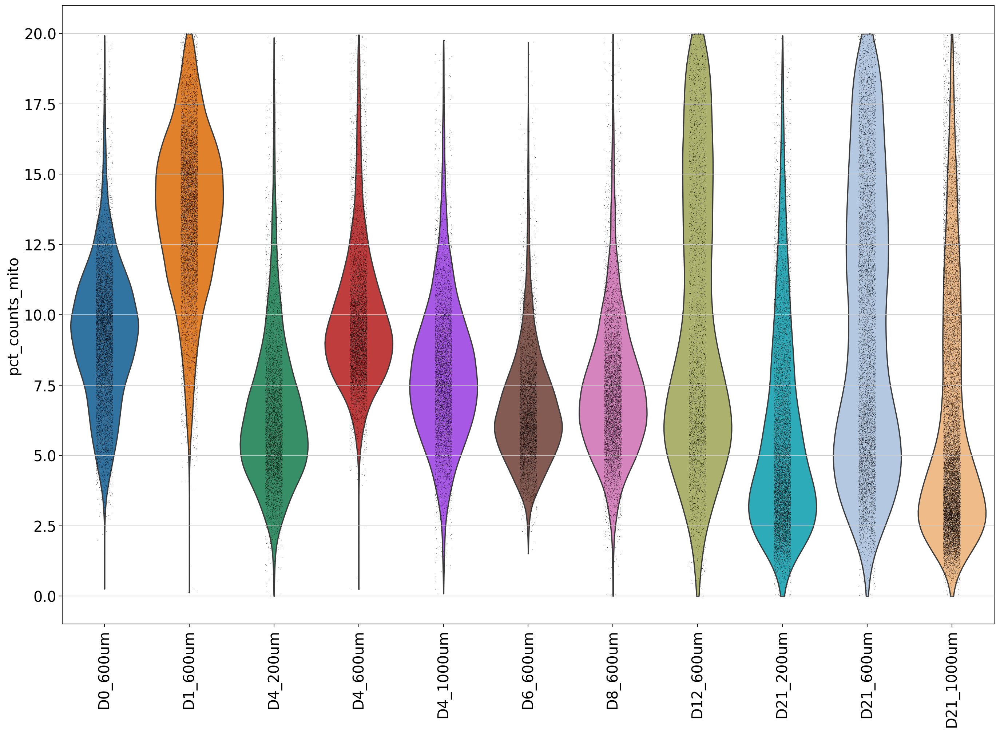

In [19]:
sc.settings.set_figure_params(
    fontsize=18,
    figsize=[16,14]
)
sc.pl.violin(
    adata,
    size=0.5,
    rotation=90,
    keys=['pct_counts_mito'],# '',''],
    groupby='sample'
)
    

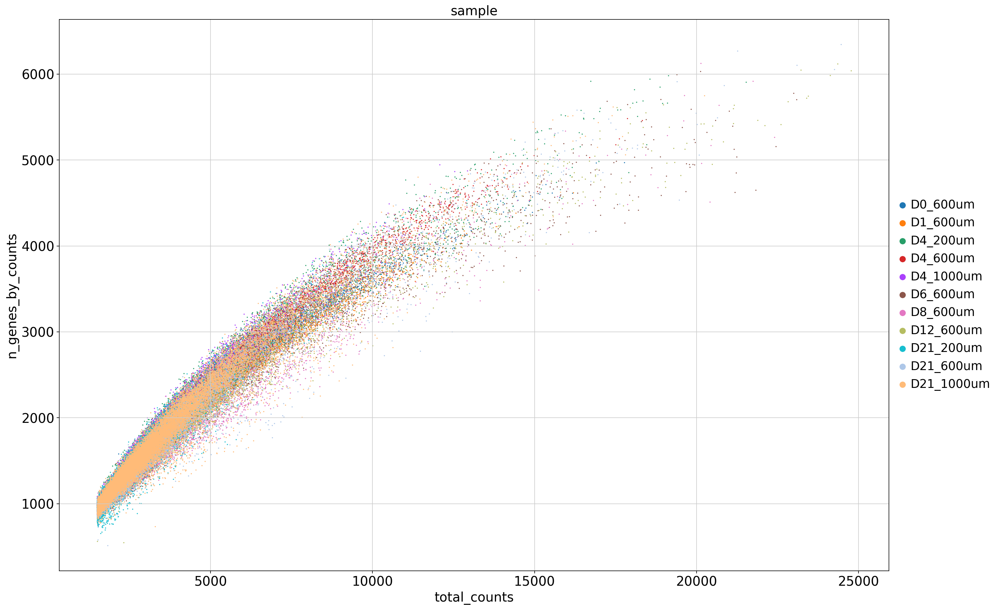

In [20]:
sc.pl.scatter(
    adata,
    size=10,
#     rotation=90,
    x='total_counts',
    y='n_genes_by_counts',
    color='sample'
)

In [21]:
## Preprocess merged object
sc.pp.normalize_total(
    adata, 
    target_sum=1e4
)

sc.pp.log1p(
    adata
)

sc.pp.highly_variable_genes(
    adata,
    subset=False
)

adata.raw = adata

normalizing counts per cell
    finished (0:00:01)
extracting highly variable genes
    finished (0:00:16)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


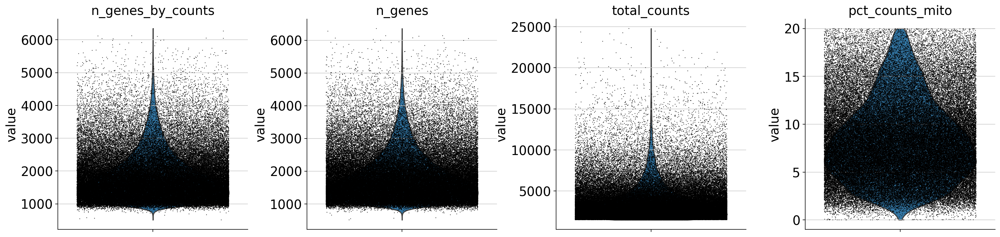

In [22]:
sc.pl.violin(
    adata, 
    ['n_genes_by_counts','n_genes', 'total_counts', 'pct_counts_mito'],
    jitter=0.4, 
    multi_panel=True
)

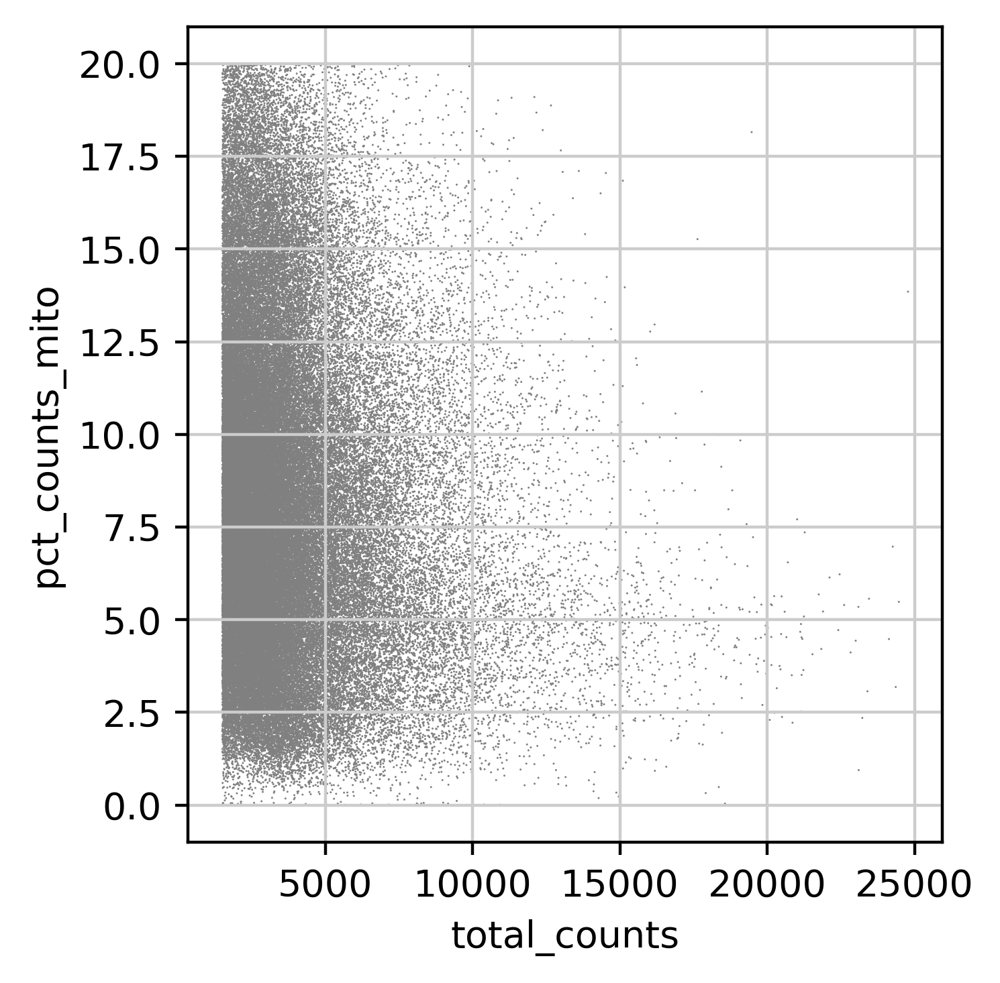

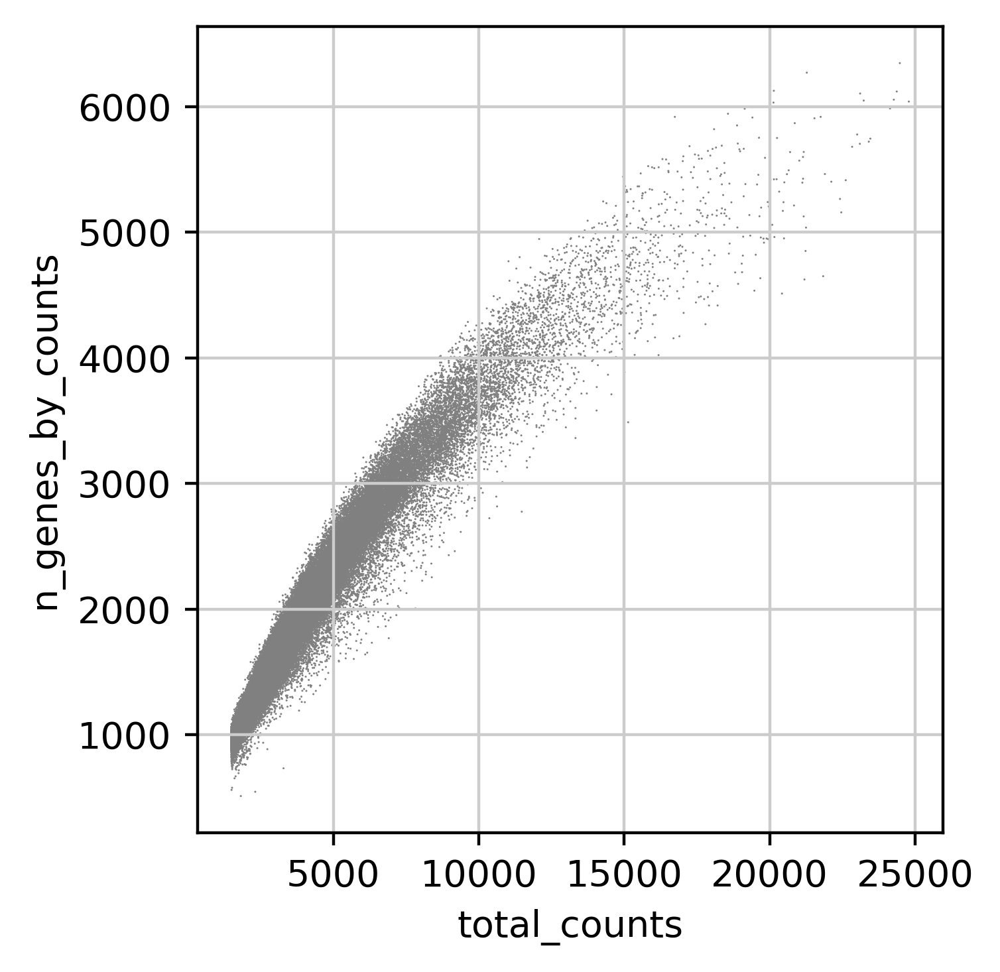

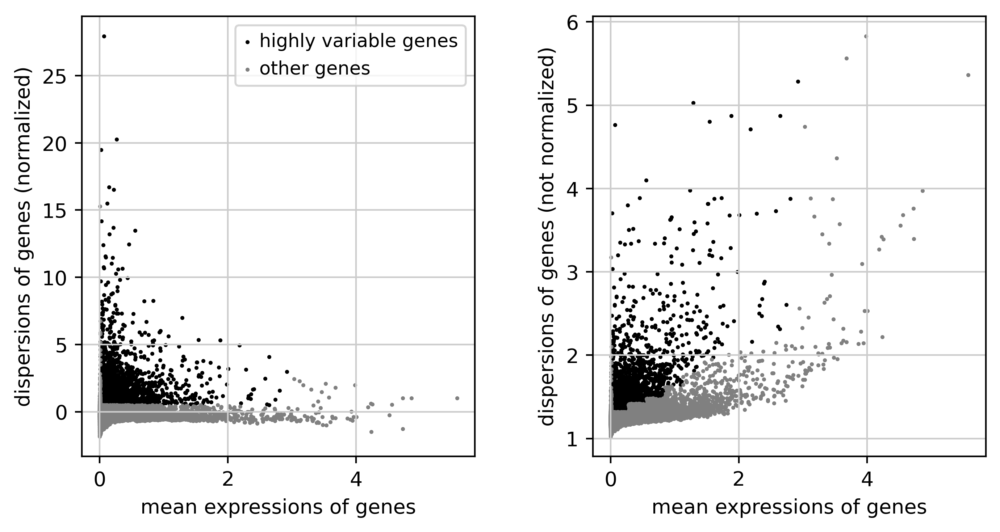

In [23]:
sc.set_figure_params(
    figsize=(4,4),
    dpi=200,
    fontsize=10
)

sc.pl.scatter(adata, x='total_counts', y='pct_counts_mito')
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')
sc.pl.highly_variable_genes(adata)

In [24]:
## Finish preprocessing w/ PCA
sc.pp.scale(
    adata, 
    max_value=10
)
sc.tl.pca(
    adata, 
    svd_solver='arpack',
    n_comps=50
)

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:49)


### Cell cycle state inference

In [25]:
#load in cell cycle genes lists
s_genes = list(pd.read_csv("resources/seurat_s_genes_2019.csv")['x'])
g2m_genes = list(pd.read_csv("resources/seurat_g2m_genes_2019.csv")['x'])

# score and plot
sc.tl.score_genes_cell_cycle(
    adata, 
    s_genes=s_genes, 
    g2m_genes=g2m_genes, 
    use_raw=False
)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    472 total control genes are used. (0:00:27)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    514 total control genes are used. (0:00:27)
-->     'phase', cell cycle phase (adata.obs)


### Harmony integration

In [26]:
sce.pp.harmony_integrate(
    adata=adata, 
    key=["sample","phase"], 
    basis='X_pca',
    adjusted_basis='X_pca_harmony'
)

2022-05-25 08:55:52,002 - harmonypy - INFO - Iteration 1 of 10
2022-05-25 08:57:42,394 - harmonypy - INFO - Iteration 2 of 10
2022-05-25 08:59:30,954 - harmonypy - INFO - Iteration 3 of 10
2022-05-25 09:01:22,028 - harmonypy - INFO - Converged after 3 iterations


In [27]:
# Re-order harmony dimensions by variance
get_var = lambda i: np.var(adata.obsm["X_pca_harmony"][:,i])
var_tmp = [get_var(i) for i in list(range(0,adata.obsm["X_pca_harmony"].shape[1]))]
print("Harmony PC variance:")
print(var_tmp)

pc_order = np.argsort(var_tmp)[::-1]
adata.obsm["X_pca_harmony"] = adata.obsm["X_pca_harmony"][:,pc_order]

Harmony PC variance:
[41.681328, 17.751982, 22.941507, 5.648133, 5.3631153, 7.211723, 6.004725, 5.8077826, 3.8113642, 5.7793384, 4.408928, 3.6739132, 1.6802435, 2.7419977, 2.6599033, 2.9938, 3.764057, 1.8642955, 2.2681086, 2.2124267, 2.2314844, 1.9560555, 2.008525, 1.917413, 1.7010392, 1.8614395, 1.7203264, 1.75727, 1.8710418, 1.7277079, 1.7291409, 1.5604616, 1.7767177, 1.739053, 1.5068653, 1.4586805, 1.4597019, 1.5982038, 1.4803195, 1.5635158, 1.4706825, 1.5341415, 1.4126501, 1.4818718, 1.3486559, 1.4428158, 1.3038055, 1.3304535, 1.3958559, 1.251251]


In [28]:
# New variance order!
print([get_var(i) for i in list(range(0,adata.obsm["X_pca_harmony"].shape[1]))])

[41.681328, 22.941507, 17.751982, 7.211723, 6.004725, 5.8077826, 5.7793384, 5.648133, 5.3631153, 4.408928, 3.8113642, 3.764057, 3.6739132, 2.9938, 2.7419977, 2.6599033, 2.2681086, 2.2314844, 2.2124267, 2.008525, 1.9560555, 1.917413, 1.8710418, 1.8642955, 1.8614395, 1.7767177, 1.75727, 1.739053, 1.7291409, 1.7277079, 1.7203264, 1.7010392, 1.6802435, 1.5982038, 1.5635158, 1.5604616, 1.5341415, 1.5068653, 1.4818718, 1.4803195, 1.4706825, 1.4597019, 1.4586805, 1.4428158, 1.4126501, 1.3958559, 1.3486559, 1.3304535, 1.3038055, 1.251251]


### Clustering (test multiple resolutions)

In [29]:
sc.pp.neighbors(
    adata,
    n_neighbors=50,
    n_pcs=npcs(adata,reduction="X_pca_harmony"),
    use_rep="X_pca_harmony"
)
gc.collect()

computing neighbors
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:04)


26721

In [30]:
sc.tl.leiden(
    adata,
    resolution=1.0,
    key_added='leiden_harmony_10'
)
gc.collect()

running Leiden clustering
    finished: found 14 clusters and added
    'leiden_harmony_10', the cluster labels (adata.obs, categorical) (0:05:37)


0

In [31]:
sc.tl.umap(
    adata,
    neighbors_key ="neighbors"
)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:05:41)


In [32]:
gc.collect()

38434

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'phase' as categorical
/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


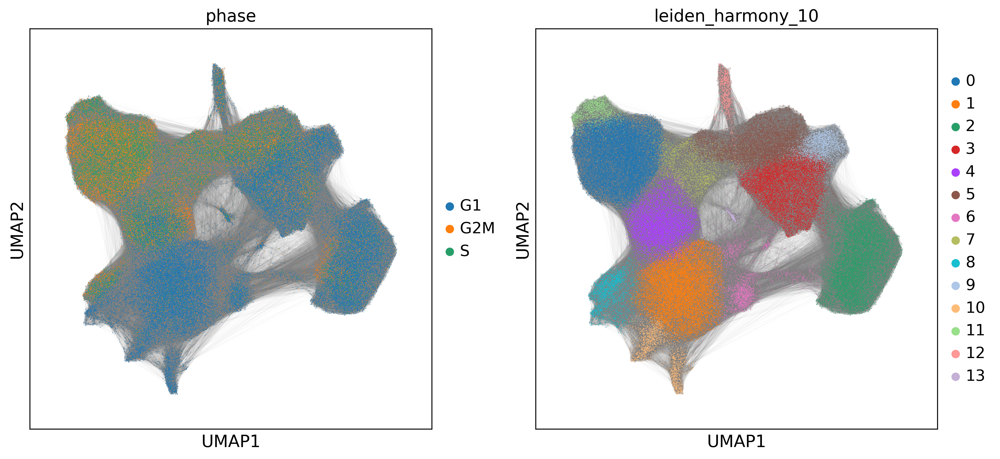

In [33]:
sc.set_figure_params(
    figsize=(6,6),
    dpi=200
)
sc.pl.umap(
    adata, 
#     color=['sample', 'phase','timepoint','leiden_harmony'],
    color=['phase','leiden_harmony_10'],
    edges=True, edges_width=0.01,
    use_raw=False,
    ncols=2    
)

## PHATE

In [34]:
# PHATE reduction of Harmony embedding
# https://nbviewer.jupyter.org/github/KrishnaswamyLab/PHATE/blob/master/Python/tutorial/EmbryoidBody.ipynb
import phate
phate_operator = phate.PHATE(
#     knn=50,
#     decay=40,
    t='auto',
    mds_solver='smacof',
    n_jobs=18
)

# Use top N harmony dims
n_dims=npcs(adata,reduction="X_pca_harmony")
tmp_phate = phate_operator.fit_transform(adata.obsm["X_pca_harmony"][:,:n_dims]) 
adata.obsm['X_phate_harmony'] = tmp_phate

Calculating PHATE...
  Running PHATE on 104036 observations and 43 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 400.28 seconds.
    Calculating affinities...
    Calculated affinities in 32.33 seconds.
  Calculated graph and diffusion operator in 433.43 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 34.39 seconds.
    Calculating KMeans...
    Calculated KMeans in 51.55 seconds.
  Calculated landmark operator in 91.43 seconds.
  Calculating optimal t...
    Automatically selected t = 26
  Calculated optimal t in 7.47 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 3.76 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 15.41 seconds.
Calculated PHATE in 551.55 seconds.


/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


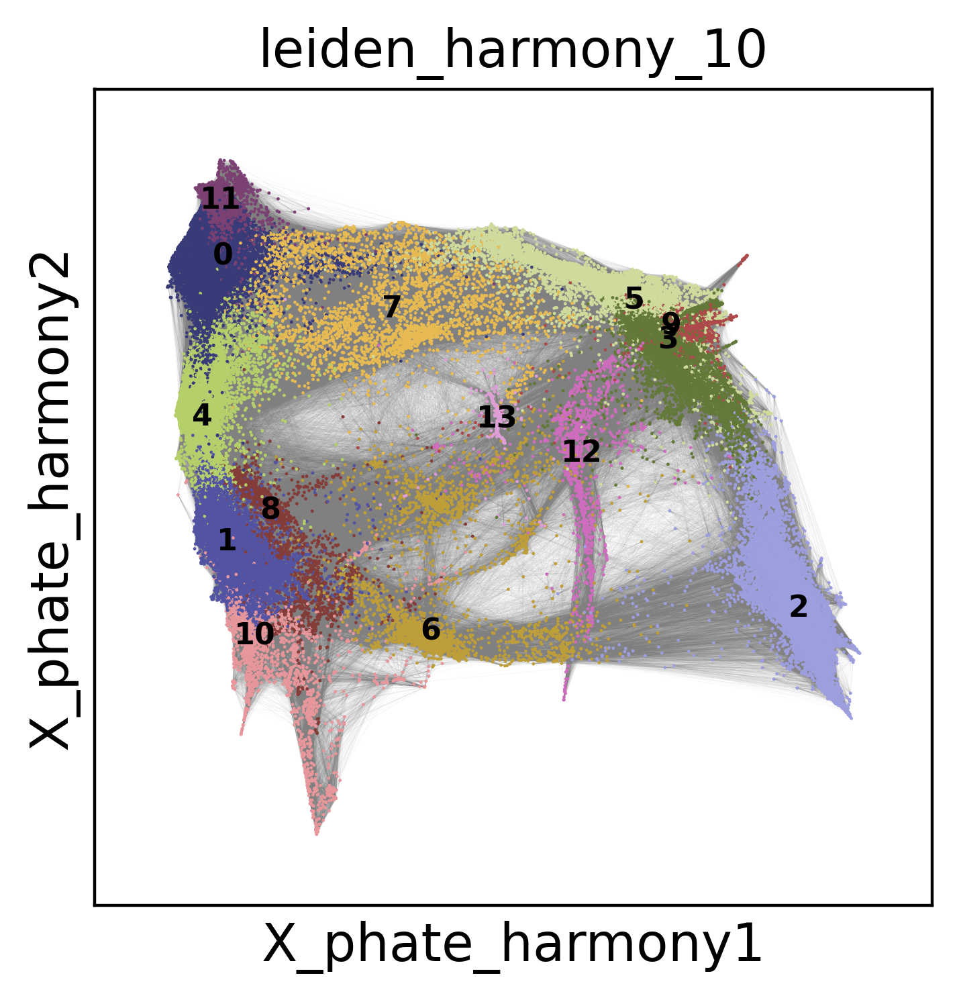

In [35]:
sc.set_figure_params(
    figsize=(4,4),
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color='leiden_harmony_10',#['sample','leiden_harmony', 'phase', "time_int"],
    edges=True, edges_width=0.005,
    palette='tab20b',
    legend_loc='on data',
#     legend_loc='right',
    legend_fontsize=8,
#      add_outline=True,
    size=3,
    sort_order=False,
    ncols=2
)

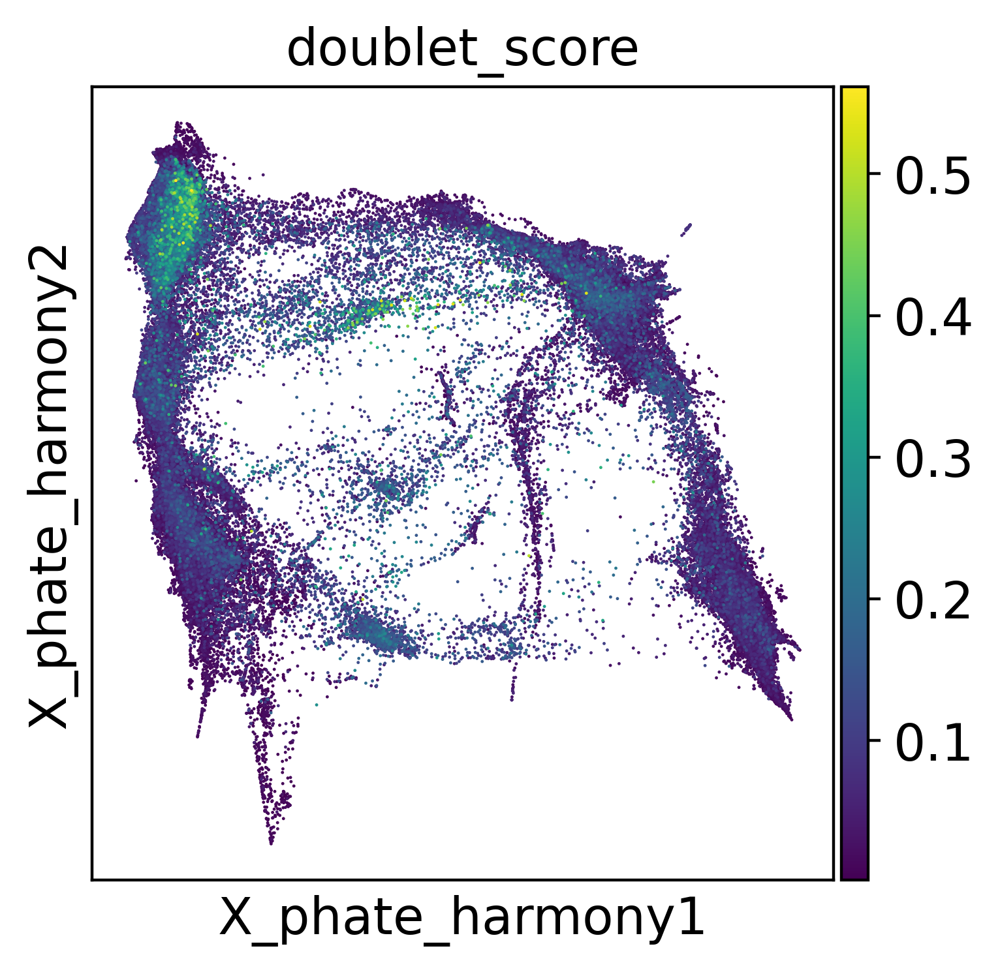

In [36]:
sc.set_figure_params(
    figsize=(4,4),
    dpi=200
)
sc.pl.embedding(
    adata,
    basis='X_phate_harmony',
    color=[ "doublet_score"], #'EPCAM','KDR', 'PECAM1',
    color_map='viridis',
    size=3,
    ncols=2,
    sort_order=True
)

/home/dwm269/miniconda3/envs/pyRNA4/lib/python3.9/site-packages/scanpy/plotting/_utils.py:314: UserWarning: Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.
  pl.show()


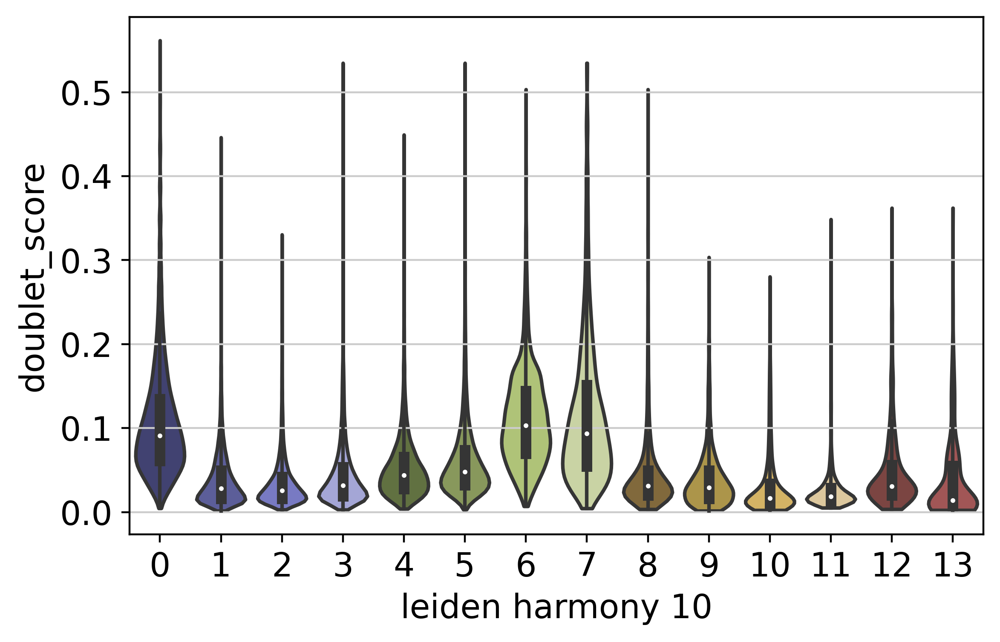

In [37]:
sc.set_figure_params(
    figsize=(6,4),
    dpi=200
)
sc.pl.violin(
    adata,
#     basis='X_phate_harmony',
    groupby='leiden_harmony_10',#['sample','leiden_harmony', 'phase', "time_int"],
    palette='tab20b',
    keys="doublet_score",
    size=0,
    inner="box"
)

### Compute/plot density across the PHATE embedding
##### https://scanpy.readthedocs.io/en/stable/generated/scanpy.tl.embedding_density.html

In [38]:
# sc.set_figure_params(figsize=(4,4),dpi=200)

# sc.tl.embedding_density(
#     adata,
#     basis='phate_harmony', 
#     groupby='timepoint'
# )
# sc.pl.embedding_density(
#     adata,
#     basis='phate_harmony',
#     key='phate_harmony_density_timepoint', 
#     bg_dotsize=5,
#     fg_dotsize=5,
#     ncols=3,
#     group=['D0','D1','D4','D6','D8','D21']
# )

## Filter out putative noisy cells/doublets

In [39]:
# Filter out cluster enriched with doublets
adata_new = adata[~adata.obs['leiden_harmony_10'].isin(['6','7']),:]

In [40]:
#  Re-compute nn graph and clustering
sc.pp.neighbors(
    adata_new,
    n_neighbors=50,
    n_pcs=50,
    use_rep="X_pca_harmony"
)

computing neighbors


Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
Observation names are not unique. To make them unique, call `.obs_names_make_unique`.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:01:16)


In [41]:
sc.tl.leiden(
    adata_new,
    resolution=1.0,
    key_added='leiden_harmony_10'
)

running Leiden clustering
    finished: found 13 clusters and added
    'leiden_harmony_10', the cluster labels (adata.obs, categorical) (0:03:58)


In [235]:
# sc.tl.leiden(
#     adata_new,
#     resolution=1.2,
#     key_added='leiden_harmony_12'
# )

In [42]:
adata_new.obs['sample'].value_counts()

D21_1000um    17853
D21_600um     10598
D1_600um      10167
D0_600um       9633
D21_200um      8850
D8_600um       8702
D4_1000um      6977
D4_600um       6889
D6_600um       6447
D4_200um       6169
D12_600um      5159
Name: sample, dtype: int64

In [43]:
phate_operator = phate.PHATE(
#     knn=50,
#     decay=40,
    t='auto',
    mds_solver='smacof',
    n_jobs=18
)

# Use top N harmony dims
n_dims=npcs(adata_new, reduction="X_pca_harmony")
tmp_phate = phate_operator.fit_transform(adata_new.obsm["X_pca_harmony"][:,:n_dims]) 
adata_new.obsm['X_phate_harmony'] = tmp_phate

Calculating PHATE...
  Running PHATE on 97444 observations and 43 variables.
  Calculating graph and diffusion operator...
    Calculating KNN search...
    Calculated KNN search in 317.55 seconds.
    Calculating affinities...
    Calculated affinities in 30.90 seconds.
  Calculated graph and diffusion operator in 349.34 seconds.
  Calculating landmark operator...
    Calculating SVD...
    Calculated SVD in 28.05 seconds.
    Calculating KMeans...
    Calculated KMeans in 48.11 seconds.
  Calculated landmark operator in 81.49 seconds.
  Calculating optimal t...
    Automatically selected t = 26
  Calculated optimal t in 6.86 seconds.
  Calculating diffusion potential...
  Calculated diffusion potential in 3.63 seconds.
  Calculating metric MDS...
  Calculated metric MDS in 42.72 seconds.
Calculated PHATE in 484.06 seconds.


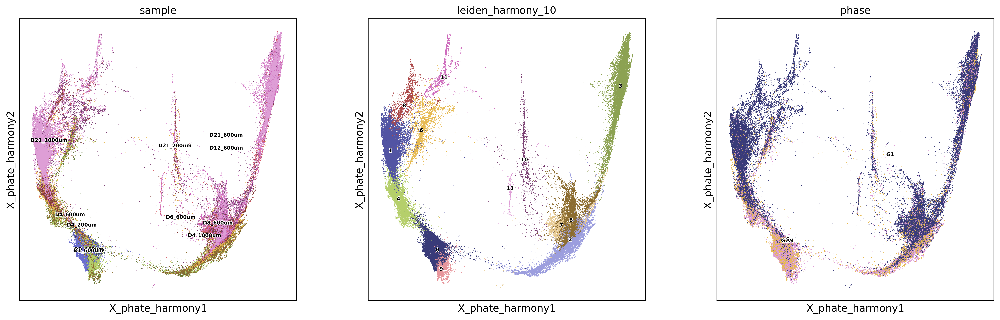

In [45]:
sc.set_figure_params(
    figsize=(6,6),
    fontsize=12,
    transparent=True,
    dpi=200
)
sc.pl.embedding(
    adata_new,
    basis='X_phate_harmony',
    color=['sample','leiden_harmony_10','phase'],
#     color=['leiden_harmony','leiden_harmony_10', 'leiden_harmony_12', 'leiden_harmony_15'],
#     color = ['APOA1','KDR', 'FAM184A','CDH2'],
#     color = ['GATA2','GATA3', 'GATA4','GATA6'],
#     color=['pattern_timepoint'],
#     edges=True, edges_width=0.01, 
    edges=False, legend_loc='on data', legend_fontsize=6,legend_fontoutline=1, #labels on plot
    palette='tab20b',
    color_map='cividis',
    size=3,
    sort_order=False,
#     return_fig=True,
    ncols=3
)

In [193]:
# sc.set_figure_params(
#     figsize=(5,5),
#     dpi=200
# )

# sc.tl.embedding_density(
#     adata_new,
#     basis='phate_harmony', 
#     groupby='pattern'
# )
# sc.pl.embedding_density(
#     adata_new,
#     basis='phate_harmony',
#     key='phate_harmony_density_pattern', 
#     bg_dotsize=3,
#     fg_dotsize=3,
#     ncols=3,
#     color_map="YlGnBu",
#     group=['200um','600um','1000um']
# )

In [ ]:
# import pandas as pd
# tmp = np.core.defchararray.add(
#         list(adata_new.obs['pattern']),
#         list(adata_new.obs['timepoint'])
#     )

# for x in ['600umD0', '600umD1', '600umD12', '600umD6', '600umD8']:
#     tmp[tmp==x] = "other"
    
# print(np.unique(tmp))

# adata_new.obs['pattern_timepoint'] = tmp

In [ ]:
# sc.set_figure_params(
#     figsize=(5,5),
#     dpi=200
# )

# sc.tl.embedding_density(
#     adata_new,
#     basis='phate_harmony',
#     groupby='pattern_timepoint'
# )

# sc.pl.embedding_density(
#     adata_new,
#     basis='phate_harmony',
#     key='phate_harmony_density_pattern_timepoint', 
#     bg_dotsize=3,
#     fg_dotsize=3,
#     ncols=3,
#     color_map="YlGnBu",
#     group=['200umD4','600umD4','1000umD4','200umD21','600umD21','1000umD21']
# )

## DGEA

In [ ]:
# Subset D4 cells
# d4_adata = adata_new[~adata_new.obs['timepoint'].isin(['D4']),:]
d4_adata = adata_new[adata_new.obs['timepoint']=='D4',:]

In [ ]:
# Run DGEA across spot sizes
sc.tl.rank_genes_groups(
    d4_adata,
    'pattern',
    method='logreg' #wilcoxon
)

# visualize the results
sc.pl.rank_genes_groups(
    d4_adata,
    n_gene=30,
    ncols=5
)

In [ ]:
d4_genes = {
    '200um':['STEAP1B','HAS2','DSCAM','BMPER','PRTG','COLEC12','SERPINE2','HAS2','HAPLN2'],
    '600um':['MT-RNR2','MT-ND1','NPM1','TKT','MYH6','MTATP6P1'],
    '1000um':['AFP','TTR','CDH2','MGST3','SPINK1','AMBP','MAGI1']
}

In [ ]:
sc.set_figure_params(
#     figsize=(6,6),
    transparent=True
)

sc.pl.dotplot(
    d4_adata,
    var_names=d4_genes,
    groupby='leiden_harmony_types', 
#     layer="counts",
#     color_map="viridis",
    title="D4 Diff. Expressed Genes",
    color_map='Greys',
    use_raw=False,
    standard_scale ='var',
#     swap_axes=True,
    dendrogram=False
)

In [240]:
gc.collect()

4211345

#### D21 DGEA

In [ ]:
# Subset D21 cells
# d21_adata = adata_new[~adata_new.obs['timepoint'].isin(['D21']),:]
d21_adata = adata_new[adata_new.obs['timepoint']=='D21',:]

In [ ]:
# Run DGEA across spot sizes

sc.tl.rank_genes_groups(
    d21_adata,
    'patterm',
    method='logreg' #wilcoxon
)

# visualize the results
sc.pl.rank_genes_groups(
    d21_adata,
    n_gene=30,
    ncols=5
)

In [ ]:
d21_genes = {
    '200um':['STEAP1B','LINC00458','SERPINE2','HAS2','DSCAM','FBN2','MIR302CHG','SFRP1','HAPLN2'],
    '600um':['GAPDH','SLC25A3','MT-ND4','MT-ND5','FTL','CKB','TPI1'],
    '1000um':['STEAP1B','HAS2','PRTG','DSCAM','HAPLN1','BMPER','CGNL1','TEAD1']
}

In [ ]:
sc.set_figure_params(
#     figsize=(6,6),
    transparent=True
)

sc.pl.dotplot(
    d21_adata,
    var_names=d21_genes,
    groupby='leiden_harmony_types', 
#     layer="counts",
#     color_map="viridis",
    title="D21 Diff. Expressed Genes",
    color_map='Greys',
    use_raw=False,
    standard_scale ='var',
#     swap_axes=True,
    dendrogram=False
)

### 3D PHATE

In [ ]:
phate_operator = phate.PHATE(
    knn=40,
    decay=40,
    t='auto',
    mds_solver='smacof',
    n_components=3,
    n_jobs=30
)

tmp_phate = phate_operator.fit_transform(adata_new.obsm["X_pca_harmony"][:,:50]) 
adata_new.obsm['X_phate_harmony_3D'] = tmp_phate


In [ ]:
sc.set_figure_params(figsize=(8,8),dpi=300)
sc.pl.embedding(
    adata_new,
    basis='phate_harmony_3D',
    projection='3d',
    color=["leiden_harmony_12"], #,"doublet_score"
    size=5,
    alpha=0.4,
    ncols=2,
#     color_map='viridis',
    sort_order=False
)

## Save preprocessed object for future analyses (python & R)

In [ ]:
# Make sure that time points are saved as a continuous variable, not a categorical variable
adata_new.obs["time_int"] = adata_new.obs["time_int"].astype("float")

In [46]:
# Save h5ad object for subsequent python analyses
adata_new.write("pyobjs/ma_iPSC_v4.h5ad")

# Save Seurat compatible object for subsequent R analyses
#TODO
# https://mojaveazure.github.io/seurat-disk/articles/convert-anndata.html

In [13]:
## Load in adata object
adata_new = sc.read_h5ad(
    filename="/workdir/dwm269/scCardiacOrganoid/pyobjs/ma_iPSC_v4.h5ad"
)

Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
